# GTZAN_1_KNN
---

In [1]:
import numpy as np
import pandas as pd
import pickle
import librosa

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline


from sklearn.metrics import confusion_matrix, classification_report, roc_curve, auc, plot_confusion_matrix, plot_precision_recall_curve, plot_roc_curve, precision_score, recall_score
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.decomposition import PCA

# Read in file

In [2]:
# read in file
filepath = '../gtzan/own_csv/df_noduplicates.csv'
df_3 = pd.read_csv(filepath, index_col=0)

# drop columns: 'filename', 'length' 
df_3.drop(columns=['filename', 'length'], inplace=True)

print(df_3.shape)
df_3.head(3)

(9847, 58)


,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,rolloff_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,3714.560359,1.080790e+06,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,3869.682242,6.722448e+05,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,3997.639160,7.907127e+05,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues


# Set target, predictors, standardization
---

In [3]:
# set target and features
X = df_3.copy()
y = X.pop('label')

# train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=1)

# standardscaler
scaler = StandardScaler()
X_train = pd.DataFrame(scaler.fit_transform(X_train), columns=X.columns, index=X_train.index)
X_test = pd.DataFrame(scaler.transform(X_test), columns=X.columns, index=X_test.index)

# Baseline
print('Baseline:')
y_test.value_counts(normalize=True)

Baseline:


jazz         0.101523
blues        0.101523
classical    0.101523
country      0.101015
rock         0.100508
disco        0.100508
reggae       0.100000
hiphop       0.099492
pop          0.099492
metal        0.094416
Name: label, dtype: float64

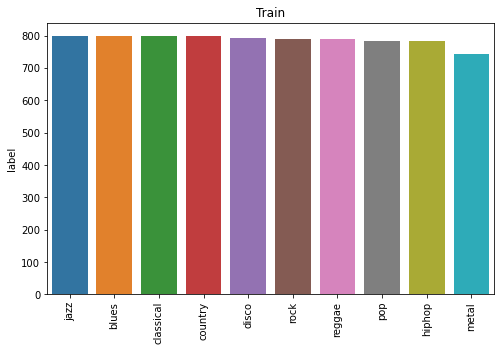

In [4]:
fig, ax = plt.subplots(1,1, figsize=(8,5))
sns.barplot(x=y_train.value_counts(normalize=True).index, y=y_train.value_counts(normalize=False), ax=ax)
plt.title('Train')
plt.xticks(rotation='vertical')

plt.show()

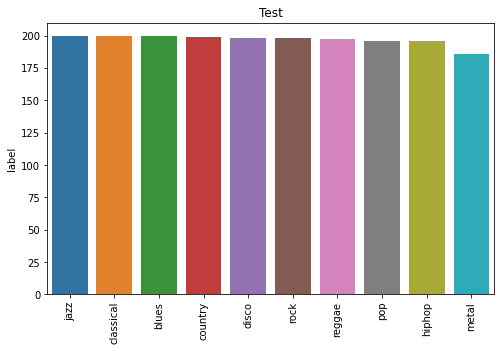

In [5]:
fig, ax = plt.subplots(1,1, figsize=(8,5))

sns.barplot(x=y_test.value_counts(normalize=True).index, y=y_test.value_counts(normalize=False), ax=ax)
plt.title('Test')
plt.xticks(rotation='vertical')
plt.show()

### PCA (all features)
---

In [5]:
# PCA (n_components: 0.9999)
n_components = 0.9999
pca = PCA(n_components=n_components, random_state=1, svd_solver='full')
X_train_pc = pd.DataFrame(pca.fit_transform(X_train), 
                         columns=[f'PC_{i+1}' for i in range(pca.n_components_)], index=X_train.index)

X_test_pc = pd.DataFrame(pca.transform(X_test), 
                         columns=[f'PC_{i+1}' for i in range(pca.n_components_)], index=X_test.index)

display(X_train_pc.head(3))
print(pca.explained_variance_ratio_.cumsum())

,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,...,PC_47,PC_48,PC_49,PC_50,PC_51,PC_52,PC_53,PC_54,PC_55,PC_56
6535,-5.273166,-6.167187,1.345471,1.123555,-0.603370,0.771625,0.755719,-1.004752,-0.159771,-0.063493,...,0.121074,-0.019945,0.445561,0.271364,-0.479309,-0.523248,0.187016,0.103133,-0.100394,0.014560
625,-0.515342,1.813487,4.630386,1.915605,1.681363,0.436591,-2.147151,-0.577363,-0.365986,-0.371310,...,0.064622,0.632422,0.140321,0.062738,0.381988,0.037552,-0.210541,-0.120403,-0.048747,-0.000290
1949,-1.794878,2.274721,3.316637,3.989158,-2.708549,1.932897,3.609233,2.383106,-3.494039,4.396239,...,0.203891,0.191172,-0.026600,0.886325,0.137341,-0.311034,0.018842,-0.080876,-0.192847,-0.346759


[0.19693593 0.33277709 0.43657312 0.50294066 0.54678617 0.58377001
 0.61335998 0.64023907 0.6654956  0.68693547 0.70569705 0.72351818
 0.74058495 0.75561978 0.76921124 0.78091766 0.79207139 0.8028624
 0.81266499 0.82197806 0.8307666  0.8393097  0.84764316 0.85579663
 0.86365234 0.8712389  0.8787581  0.88603821 0.89305122 0.89996235
 0.90665321 0.91317655 0.91945846 0.92558516 0.93161825 0.93740046
 0.94281321 0.94806709 0.95306707 0.95768618 0.96227398 0.96674103
 0.97104055 0.97518641 0.97913969 0.98283504 0.9863513  0.98951242
 0.99244916 0.99497769 0.99679816 0.99807571 0.99902133 0.99959884
 0.99980932 0.99994241]


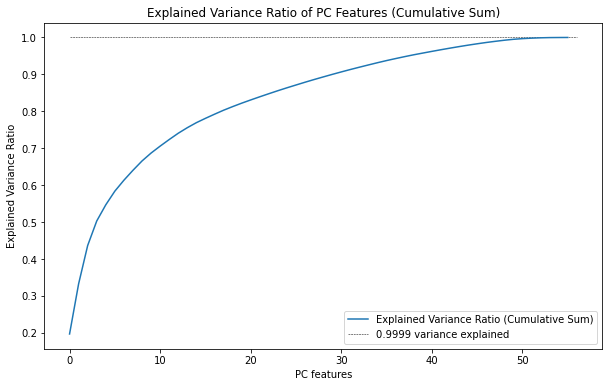

In [6]:
fig, ax = plt.subplots(1,1, figsize=(10,6))
plt.plot(pca.explained_variance_ratio_.cumsum(), label='Explained Variance Ratio (Cumulative Sum)')
plt.hlines(y=n_components, xmin=0, xmax=len(pca.explained_variance_ratio_), colors='k', linestyles='dashed', lw=0.5, label=f'{n_components} variance explained', data=None)
plt.legend(loc='lower right')
plt.xlabel('PC features')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance Ratio of PC Features (Cumulative Sum)')
plt.show()


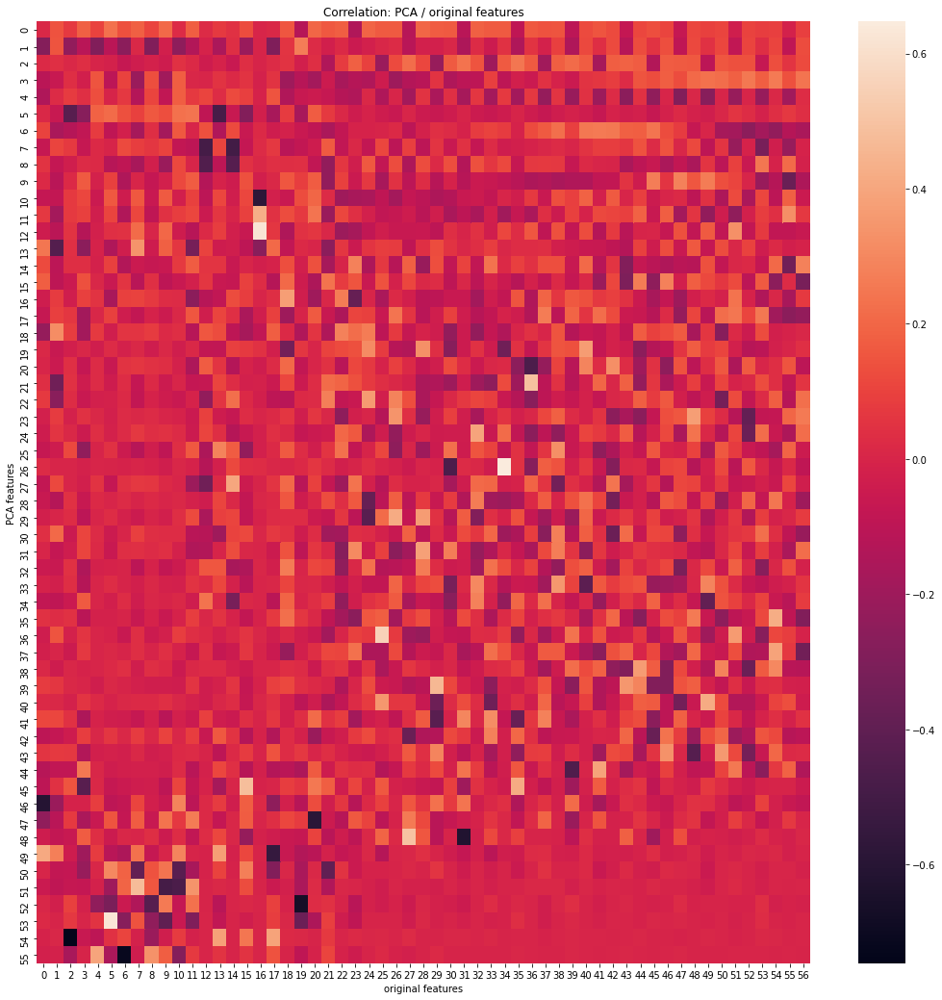

In [53]:
fig, ax = plt.subplots(1,1, figsize=(18,18))
sns.heatmap(pca.components_, ax=ax)
ax.set_xlabel('original features')
ax.set_ylabel('PCA features')
ax.set_title('Correlation: PCA / original features')
plt.show()

In [54]:
print(y_train.shape)
X_train_pc

(7877,)


,PC_1,PC_2,PC_3,PC_4,PC_5,PC_6,PC_7,PC_8,PC_9,PC_10,...,PC_47,PC_48,PC_49,PC_50,PC_51,PC_52,PC_53,PC_54,PC_55,PC_56
6535,-5.273166,-6.167187,1.345471,1.123555,-0.603370,0.771625,0.755719,-1.004752,-0.159771,-0.063493,...,0.121074,-0.019945,0.445561,0.271364,-0.479309,-0.523248,0.187016,0.103133,-0.100394,0.014560
625,-0.515342,1.813487,4.630386,1.915605,1.681363,0.436591,-2.147151,-0.577363,-0.365986,-0.371310,...,0.064622,0.632422,0.140321,0.062738,0.381988,0.037552,-0.210541,-0.120403,-0.048747,-0.000290
1949,-1.794878,2.274721,3.316637,3.989158,-2.708549,1.932897,3.609233,2.383106,-3.494039,4.396239,...,0.203891,0.191172,-0.026600,0.886325,0.137341,-0.311034,0.018842,-0.080876,-0.192847,-0.346759
5149,-3.842854,1.007945,0.773644,0.336011,-0.203059,0.696469,-1.213454,-0.438072,-1.004604,-0.964293,...,-0.504805,-0.328512,-0.016508,-0.033343,0.064420,0.213274,0.068317,0.022250,0.137002,0.006368
2649,-0.612660,4.705747,-1.034093,-1.919970,2.229053,-1.394863,0.638096,0.018477,0.297663,0.631274,...,0.035095,-0.087212,-0.237619,0.427999,-0.144415,-0.140942,-0.093241,-0.037091,-0.066026,0.074241
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5813,0.503426,-2.360966,-4.180630,0.981774,1.137361,3.666197,0.264384,0.791857,-0.307244,-0.317340,...,0.548767,0.240678,0.041816,0.056237,-0.087115,-0.076996,-0.337118,0.000263,0.163505,0.079550
2415,-0.225778,-0.214537,-3.382284,-1.014698,1.858959,0.425759,1.061426,1.421216,-0.840757,-0.800579,...,-0.939128,-0.146750,0.127398,-0.287315,0.188999,0.179851,0.118621,0.080406,0.028483,-0.028013
5572,-1.292151,3.707541,-1.164382,1.572066,2.830322,-0.187799,1.638945,0.128535,0.318370,-0.378719,...,-0.693209,0.385759,-0.240923,-0.313058,-0.334601,-0.377241,-0.094333,-0.068124,0.117092,-0.082991
1686,-0.751464,3.927965,-0.684180,2.481215,1.506129,-0.817505,3.637913,1.482674,-0.316441,1.436964,...,-0.751777,0.225129,-0.013834,0.008610,-0.135459,-0.195327,0.203412,0.189617,0.046471,-0.002456


In [55]:
y_train

6535        metal
625         blues
1949    classical
5149         jazz
2649      country
          ...    
5813         jazz
2415      country
5572         jazz
1686    classical
9932         rock
Name: label, Length: 7877, dtype: object

In [100]:
data = pd.concat([X_train_pc, y_train], axis=1)
sns.pairplot(data=data, hue='label');

plt.savefig('pairplot_X_train_pc.png', dpi=300, format='png')

## KNN (PC features)

In [7]:
def knn_scores(data_train=X_train_pc, data_test=X_test_pc, 
               neighbors_min=1, neighbors_max=20, neighbors_increment=1):
    """
    fit and score for a range of knn
    """
    neighbors_range = range(neighbors_min, neighbors_max+1, neighbors_increment)
    train_scores_list = []
    test_scores_list = []
    cv_means_list = []
    error_rate = []

    for n_neighbors in neighbors_range:
        knn = KNeighborsClassifier(n_neighbors=n_neighbors)
        knn.fit(data_train, y_train)

        train_scores_list.append(knn.score(data_train, y_train))
        test_scores_list.append(knn.score(data_test, y_test))
        cv_means_list.append(cross_val_score(knn, data_train, y_train, cv=5).mean())
        
        pred_test = knn.predict(data_test)
        error_rate.append((pred_test != y_test).mean())

    df_knn_scores = pd.DataFrame({'n_neighbors':neighbors_range, 
                                 'train_scores':train_scores_list,
                                 'test_scores':test_scores_list,
                                 'cv_means':cv_means_list, 
                                 'error_rate':error_rate})

    df_knn_scores.set_index('n_neighbors', inplace=True)

    # return cv_means_max, error_rate_min (and corresponding k (num of neighbors)), on condition of k > 1
    if neighbors_min > 1:
        cv_means_max = df_knn_scores.cv_means.max()
        cv_means_max_neighbors = df_knn_scores[df_knn_scores.cv_means == df_knn_scores.cv_means.max()].index[0]
        error_rate_min = df_knn_scores.error_rate.min()
        error_rate_min_neighbors = df_knn_scores[df_knn_scores.error_rate == df_knn_scores.error_rate.min()].index[0]
    else:
        cv_means_max = df_knn_scores.iloc[1:].cv_means.max()
        cv_means_max_neighbors = df_knn_scores.iloc[1:][df_knn_scores.iloc[1:].cv_means == df_knn_scores.iloc[1:].cv_means.max()].index[0]
        error_rate_min = df_knn_scores.iloc[1:].error_rate.min()
        error_rate_min_neighbors = df_knn_scores.iloc[1:][df_knn_scores.iloc[1:].error_rate == df_knn_scores.iloc[1:].error_rate.min()].index[0]
                        
    print(f'CV means max:\t{cv_means_max}\tNeighbors: {cv_means_max_neighbors}')
    print(f'Error rate min:\t{error_rate_min}\tNeighbors: {cv_means_max_neighbors}')

    return df_knn_scores

In [8]:
# function to plot scores for varying knn
def knn_scores_plot(df):
    """
    plot scores for range of knn
    """
    cv_means_max = df.iloc[1:].cv_means.max()
    cv_means_max_neighbors = df.iloc[1:][df.iloc[1:].cv_means == df.iloc[1:].cv_means.max()].index[0]
    
    df = df.iloc[:,:-1] #exclude error rate from scale
    df.plot(figsize=(14,8))
    plt.vlines(x=cv_means_max_neighbors, 
               ymin=df.min().min(), ymax=df.max().max(), 
               colors='k', linestyles='dashed', lw=0.5, label='', data=None)
    plt.legend(loc = 'best')
    plt.xticks(range(df.index[0], df.index[-1], int((df.index[-1] - df.index[0]) / 20)+1))
    plt.title('Scores at Different k (KNN)')
    plt.xlabel('k neighbors')
    plt.ylabel('accuracy score');
    
    print(f'CV means max: {cv_means_max}\nNeighbors: {cv_means_max_neighbors}')

In [126]:
# # function to plot scores for varying knn
# def knn_scores_plot(df):
#     """
#     plot scores for range of knn
#     """
    
#     fig, ax = plt.subplots(figsize=(14,8))

#     cv_means_max = df.iloc[1:].cv_means.max()
#     cv_means_max_neighbors = df.iloc[1:][df.iloc[1:].cv_means == df.iloc[1:].cv_means.max()].index[0]
    
#     # accuracy scores plot
#     ax.plot(df_knn_scores.index, df_knn_scores[['train_scores', 'test_scores', 'cv_means']])
#     ax.set_xlabel('k neighbors')
#     ax.set_ylabel('accuracy score', color='black')

#     # error_rate plot on separate y scale
#     ax2=ax.twinx()
#     ax2.plot(df_knn_scores.index, df_knn_scores['error_rate'], '-.', color='grey')
#     ax2.set_ylabel('error_rate', color='grey')
    
    
#     plt.vlines(x=cv_means_max_neighbors, 
#                ymin=df.min().min(), ymax=df.max().max(), 
#                colors='k', linestyles='dashed', lw=0.5, label='', data=None)
#     plt.legend(loc = 'best')
#     plt.xticks(range(df.index[0], df.index[-1], int((df.index[-1] - df.index[0]) / 20)+1))
#     plt.title('Scores at Different k (KNN)')
#     plt.xlabel('k neighbors')
#     plt.ylabel('accuracy score');
    
#     print(f'CV means max: {cv_means_max}\nNeighbors: {cv_means_max_neighbors}')
#     plt.show()



    
    
    

#     plt.vlines(x=3, ymin=0, ymax=1, colors='k', linestyles='dashed', lw=0.5, label='', data=None)
#     plt.legend(loc= 'best')

#     ax.set_title('Scores at different k (KNN)')
#     plt.show()

    
#     df.plot(figsize=(14,8))
#     plt.vlines(x=cv_means_max_neighbors, 
#                ymin=df.min().min(), ymax=df.max().max(), 
#                colors='k', linestyles='dashed', lw=0.5, label='', data=None)
#     plt.legend(loc = 'best')
#     plt.xticks(range(df.index[0], df.index[-1], int((df.index[-1] - df.index[0]) / 20)+1))
#     plt.title('Scores at Different k (KNN)')
#     plt.xlabel('k neighbors')
#     plt.ylabel('accuracy score');
    
#     print(f'CV means max: {cv_means_max}\nNeighbors: {cv_means_max_neighbors}')

In [59]:
df_knn_scores = knn_scores(data_train=X_train_pc, data_test=X_test_pc, 
                           neighbors_min=1, neighbors_max=20, neighbors_increment=1)
df_knn_scores

CV means max: 0.9022470152671265
Neighbors: 1


,train_scores,test_scores,cv_means
n_neighbors,,,
1,1.000000,0.903553,0.902247
2,0.953790,0.871574,0.877363
3,0.958233,0.890863,0.885492
4,0.939952,0.876142,0.879525
5,0.934493,0.873096,0.875970
6,0.927257,0.864975,0.870764
7,0.919766,0.867513,0.866448
8,0.912657,0.860914,0.858957
9,0.907071,0.852792,0.853247


CV means max: 0.8854921987370921
Neighbors: 3


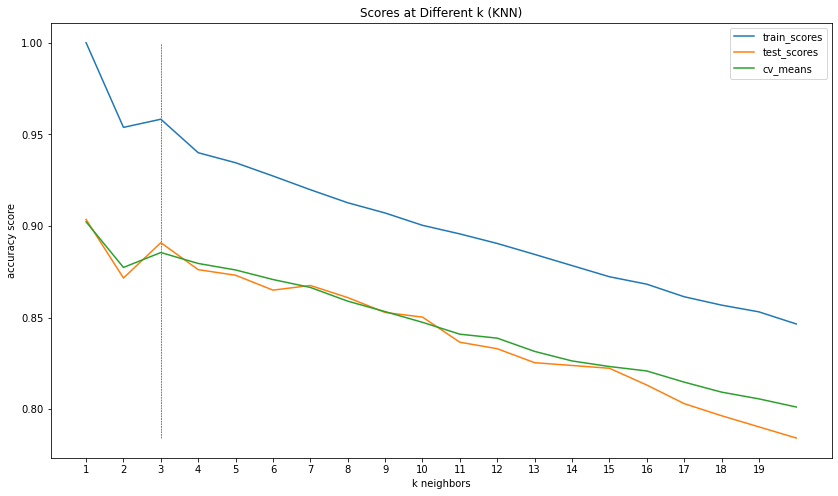

In [74]:
knn_scores_plot(df_knn_scores)

In [139]:
df_knn_scores = knn_scores(data_train=X_train_pc, data_test=X_test_pc, 
                           neighbors_min=1, neighbors_max=1000, neighbors_increment=10)
df_knn_scores.head(10)

CV means max:	0.8286146966400774	Neighbors: 11
Error rate min:	0.1634517766497462	Neighbors: 11


,train_scores,test_scores,cv_means,error_rate
n_neighbors,,,,
1,1.000000,0.903553,0.895645,0.096447
11,0.895646,0.836548,0.828615,0.163452
21,0.841056,0.785787,0.784689,0.214213
31,0.807160,0.751269,0.754221,0.248731
41,0.780500,0.738579,0.740130,0.261421
51,0.762219,0.717259,0.727815,0.282741
61,0.749397,0.710152,0.715372,0.289848
71,0.736194,0.702030,0.704581,0.297970
81,0.726292,0.690863,0.695822,0.309137


CV means max: 0.8286146966400774
Neighbors: 11


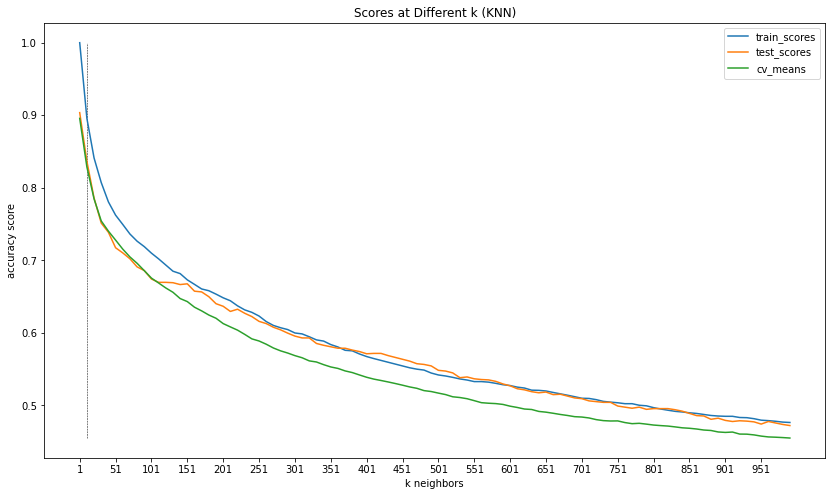

In [140]:
knn_scores_plot(df_knn_scores)

# Gridsearch KNN (PC features)

In [149]:
knn = KNeighborsClassifier()

param_grid = {'n_neighbors':list(range(1,11)), 
             'weights':['uniform', 'distance'], 
             'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute']}

grid = GridSearchCV(estimator=knn, 
                    param_grid=param_grid, 
                    cv=5, n_jobs=-2, verbose=1)

grid.fit(X_train_pc, y_train)

Fitting 5 folds for each of 80 candidates, totalling 400 fits


[Parallel(n_jobs=-2)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    9.6s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:  1.0min
[Parallel(n_jobs=-2)]: Done 400 out of 400 | elapsed:  1.7min finished


GridSearchCV(cv=5, estimator=KNeighborsClassifier(), n_jobs=-2,
             param_grid={'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
                         'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
                         'weights': ['uniform', 'distance']},
             verbose=1)

In [158]:
print('grid best estimator:\t', grid.best_estimator_)
print('grid best params:\t', grid.best_params_)
print('grid cv mean:\t\t', grid.best_score_)
print('grid test score:\t', grid.score(X_test_pc, y_test))

grid best estimator:	 KNeighborsClassifier(n_neighbors=1)
grid best params:	 {'algorithm': 'auto', 'n_neighbors': 1, 'weights': 'uniform'}
grid cv mean:		 0.8956448311981307
grid test score:	 0.9035532994923858


In [161]:
# save model to disk
filename = 'knn_grid_pc.pkl'
pickle.dump(grid, open(filename, 'wb'))

In [7]:
# read in model
filename = 'knn_grid_pc.pkl'
knn_grid_pc = pickle.load(open(filename, 'rb'))

knn_grid_pc.score(X_train_pc, y_train)

1.0

In [9]:
knn_grid_pc.predict_proba(X_train_pc)

array([[0., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 1.]])

KNN: 3 neighbors

train score:	 0.9523273273273273
cv mean:	 0.8858868898623278
test score:	 0.8818818818818819


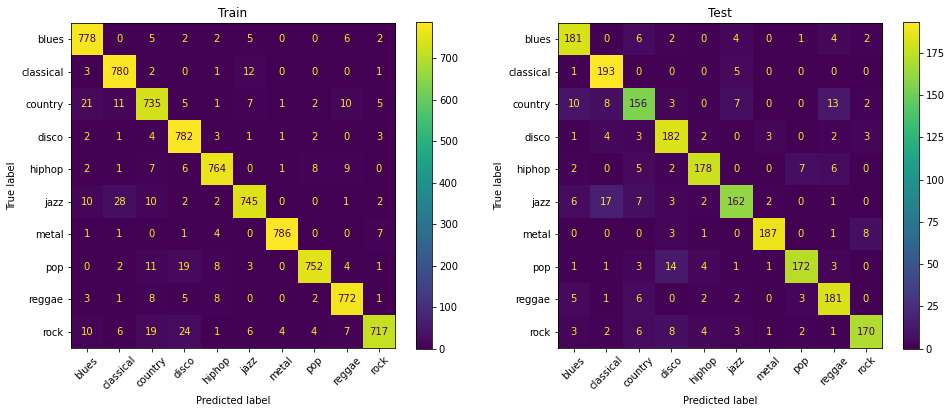

In [9]:
n_neighbors = 3
knn = KNeighborsClassifier(n_neighbors=n_neighbors)
knn.fit(X_train_pc, y_train)

train_score_knn = knn.score(X_train_pc, y_train)
cv_mean_knn = cross_val_score(knn, X_train_pc, y_train, cv=10).mean()
test_score_knn = knn.score(X_test_pc, y_test)

print(f'KNN: {n_neighbors} neighbors')
print()
print('train score:\t', train_score_knn)
print('cv mean:\t', cv_mean_knn)
print('test score:\t', test_score_knn)

# confusion matrix
pred_train = knn.predict(X_train_pc)
pred_test = knn.predict(X_test_pc)
conf_matrix = confusion_matrix(y_train, pred_train)
#display(conf_matrix)

# plot confusion matrix
fig, ax = plt.subplots(1,2, figsize=(16,6))
plot_confusion_matrix(knn, X_train_pc, y_train, ax=ax[0], xticks_rotation=45)
plot_confusion_matrix(knn, X_test_pc, y_test, ax=ax[1], xticks_rotation=45)
ax[0].set_title('Train')
ax[1].set_title('Test')
plt.show()

In [10]:
class_report = classification_report(y_train, pred_train, digits=4)
print()
print('Classification report: train set')
print()
print(class_report)

class_report = classification_report(y_test, pred_test, digits=4)
print()
print('Classification report: test set')
print()
print(class_report)


Classification report: train set

              precision    recall  f1-score   support

       blues     0.9373    0.9725    0.9546       800
   classical     0.9386    0.9762    0.9571       799
     country     0.9176    0.9211    0.9193       798
       disco     0.9243    0.9787    0.9508       799
      hiphop     0.9622    0.9574    0.9598       798
        jazz     0.9564    0.9313    0.9436       800
       metal     0.9912    0.9825    0.9868       800
         pop     0.9766    0.9400    0.9580       800
      reggae     0.9543    0.9650    0.9596       800
        rock     0.9702    0.8985    0.9330       798

    accuracy                         0.9523      7992
   macro avg     0.9529    0.9523    0.9523      7992
weighted avg     0.9529    0.9523    0.9523      7992


Classification report: test set

              precision    recall  f1-score   support

       blues     0.8619    0.9050    0.8829       200
   classical     0.8540    0.9698    0.9082       199
     coun

In [11]:
knn.predict_proba(X_train_pc)

array([[0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 0., 1.]])

KNN: 5 neighbors

train score:	 0.9343093093093093
cv mean:	 0.8768790675844806
test score:	 0.8648648648648649


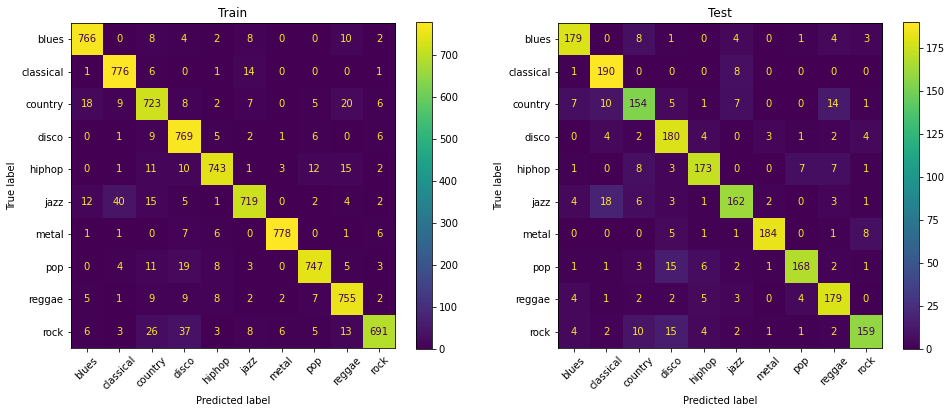

In [71]:
n_neighbors = 5
knn = KNeighborsClassifier(n_neighbors=n_neighbors)
knn.fit(X_train_pc, y_train)

train_score_knn = knn.score(X_train_pc, y_train)
cv_mean_knn = cross_val_score(knn, X_train_pc, y_train, cv=10).mean()
test_score_knn = knn.score(X_test_pc, y_test)

print(f'KNN: {n_neighbors} neighbors')
print()
print('train score:\t', train_score_knn)
print('cv mean:\t', cv_mean_knn)
print('test score:\t', test_score_knn)

# confusion matrix
pred_train = knn.predict(X_train_pc)
pred_test = knn.predict(X_test_pc)
conf_matrix = confusion_matrix(y_train, pred_train)
#display(conf_matrix)

# plot confusion matrix
fig, ax = plt.subplots(1,2, figsize=(16,6))
plot_confusion_matrix(knn, X_train_pc, y_train, ax=ax[0], xticks_rotation=45)
plot_confusion_matrix(knn, X_test_pc, y_test, ax=ax[1], xticks_rotation=45)
ax[0].set_title('Train')
ax[1].set_title('Test')
plt.show()

In [72]:
class_report = classification_report(y_train, pred_train, digits=4)
print()
print('Classification report: train set')
print()
print(class_report)

class_report = classification_report(y_test, pred_test, digits=4)
print()
print('Classification report: test set')
print()
print(class_report)


Classification report: train set

              precision    recall  f1-score   support

       blues     0.9468    0.9575    0.9521       800
   classical     0.9282    0.9712    0.9492       799
     country     0.8839    0.9060    0.8948       798
       disco     0.8859    0.9625    0.9226       799
      hiphop     0.9538    0.9311    0.9423       798
        jazz     0.9411    0.8988    0.9194       800
       metal     0.9848    0.9725    0.9786       800
         pop     0.9528    0.9337    0.9432       800
      reggae     0.9174    0.9437    0.9304       800
        rock     0.9584    0.8659    0.9098       798

    accuracy                         0.9343      7992
   macro avg     0.9353    0.9343    0.9343      7992
weighted avg     0.9353    0.9343    0.9343      7992


Classification report: test set

              precision    recall  f1-score   support

       blues     0.8905    0.8950    0.8928       200
   classical     0.8407    0.9548    0.8941       199
     coun

# KNN (original features)

In [167]:
df_knn_scores = knn_scores(data_train=X_train, data_test=X_test, 
                           neighbors_min=1, neighbors_max=20, neighbors_increment=1)
df_knn_scores

CV means max:	0.8774902908710015	Neighbors: 3
Error rate min:	0.10913705583756345	Neighbors: 3


,train_scores,test_scores,cv_means,error_rate
n_neighbors,,,,
1,1.000000,0.903553,0.895518,0.096447
2,0.953790,0.871574,0.867714,0.128426
3,0.957979,0.890863,0.877490,0.109137
4,0.940079,0.876142,0.870889,0.123858
5,0.934493,0.873096,0.866953,0.126904
6,0.927257,0.865482,0.860606,0.134518
7,0.920020,0.867513,0.854892,0.132487
8,0.912657,0.860406,0.847147,0.139594
9,0.906690,0.853299,0.840165,0.146701


CV means max: 0.8774902908710015
Neighbors: 3


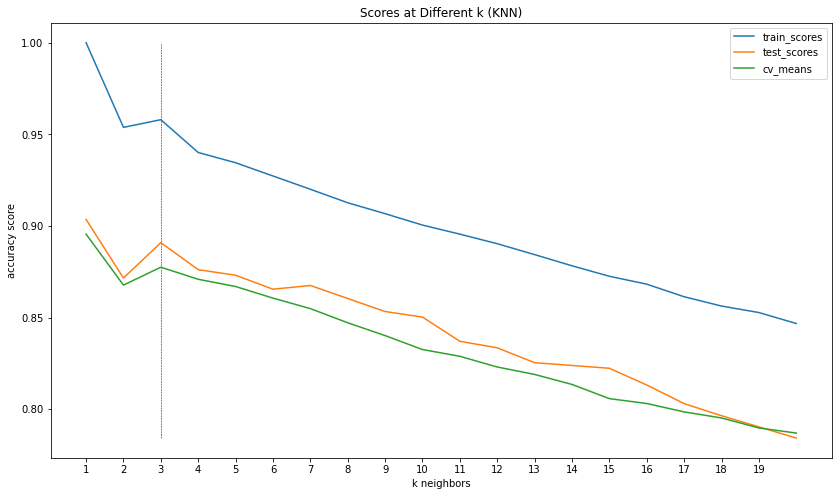

In [168]:
knn_scores_plot(df_knn_scores)

# Gridsearch KNN (original features)

In [169]:
knn = KNeighborsClassifier()

param_grid = {'n_neighbors':list(range(1,11)), 
             'weights':['uniform', 'distance'], 
             'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute']}

grid = GridSearchCV(estimator=knn, 
                    param_grid=param_grid, 
                    cv=5, n_jobs=-2, verbose=1)

grid.fit(X_train, y_train)

Fitting 5 folds for each of 80 candidates, totalling 400 fits


[Parallel(n_jobs=-2)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:   15.0s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-2)]: Done 400 out of 400 | elapsed:  1.8min finished


GridSearchCV(cv=5, estimator=KNeighborsClassifier(), n_jobs=-2,
             param_grid={'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
                         'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
                         'weights': ['uniform', 'distance']},
             verbose=1)

In [171]:
print('grid best estimator:\t', grid.best_estimator_)
print('grid best params:\t', grid.best_params_)
print('grid cv mean:\t\t', grid.best_score_)
print('grid test score:\t', grid.score(X_test, y_test))

grid best estimator:	 KNeighborsClassifier(n_neighbors=1)
grid best params:	 {'algorithm': 'auto', 'n_neighbors': 1, 'weights': 'uniform'}
grid cv mean:		 0.8955179276448313
grid test score:	 0.9035532994923858


In [172]:
# save model to disk
filename = 'knn_grid_orig.pkl'
pickle.dump(grid, open(filename, 'wb'))

In [6]:
# read in model
filename = 'knn_grid_orig.pkl'
knn_grid_orig = pickle.load(open(filename, 'rb'))

print('Grid params:\t', knn_grid_orig.best_params_)
print('cv mean:\t', knn_grid_orig.best_score_)
print('train score:\t', knn_grid_orig.score(X_train, y_train))
print('test score:\t', knn_grid_orig.score(X_test, y_test))

Grid params:	 {'algorithm': 'auto', 'n_neighbors': 1, 'weights': 'uniform'}
cv mean:	 0.8955179276448313
train score:	 1.0
test score:	 0.9035532994923858


In [7]:
knn_grid_orig.predict(X_test)

array(['reggae', 'classical', 'reggae', ..., 'jazz', 'pop', 'hiphop'],
      dtype=object)

In [8]:
df_test_pred = X_test.copy()
df_test_pred['label'], df_test_pred['pred'] = y_test, knn_grid_orig.predict(X_test)
df_test_pred['true_false'] = (df_test_pred.label == df_test_pred.pred)

df_test_pred.head()

,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,rolloff_var,...,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label,pred,true_false
8122,0.006466,1.151329,-0.454924,-0.096288,-1.013039,-0.124978,-0.472557,1.576594,-0.823101,1.172676,...,0.685169,0.102035,0.433280,0.836686,1.698576,0.811672,0.855189,reggae,reggae,True
1323,-1.067772,0.241611,-1.850736,-0.762137,-1.830441,-0.939590,-1.743596,-0.996691,-1.988989,-1.049288,...,-0.941740,-0.516908,-0.830237,-0.674110,-0.465485,-0.016296,-0.759773,classical,classical,True
8394,-0.920652,0.402533,-1.376231,-0.589758,-0.413033,0.757470,-0.973097,0.008645,-0.633901,0.001642,...,-0.151185,0.337173,-0.056954,-0.279196,0.438655,-0.289404,0.486277,reggae,reggae,True
209,-0.972974,0.934979,-0.449765,0.554635,-0.860937,-0.368567,-0.603189,-0.580789,-0.836579,-0.425182,...,0.189558,0.383374,2.437225,0.846272,4.425751,0.644944,1.329055,blues,blues,True
1999,-0.116581,-0.553790,1.785218,-0.628560,0.972471,0.606618,1.367279,-0.059064,1.223867,0.352396,...,-0.489234,-0.535900,-0.376840,-0.154197,0.496323,1.063757,0.258897,country,jazz,False


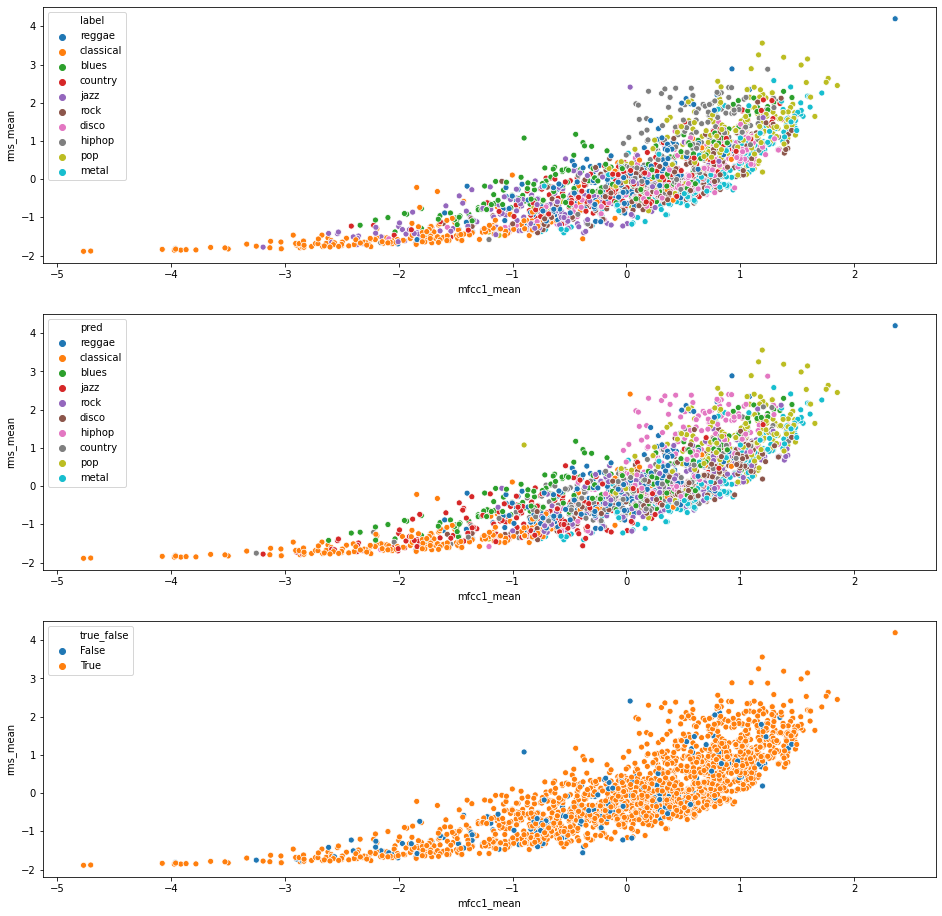

In [9]:
fig, ax = plt.subplots(3,1, figsize=(16,16))

sns.scatterplot(x='mfcc1_mean', y='rms_mean', data=df_test_pred, hue='label', ax=ax[0])
sns.scatterplot(x='mfcc1_mean', y='rms_mean', data=df_test_pred, hue='pred', ax=ax[1])
sns.scatterplot(x='mfcc1_mean', y='rms_mean', data=df_test_pred, hue='true_false', ax=ax[2])

# plt.xscale('log')
# plt.yscale('log')
plt.show()

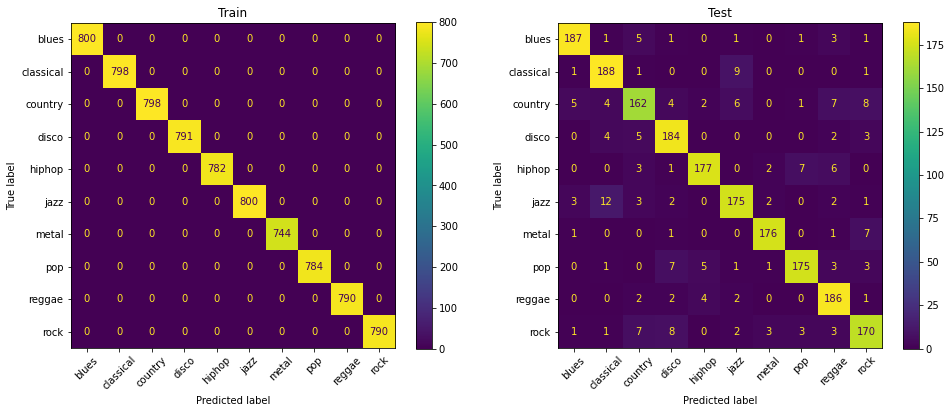

In [10]:
# confusion matrix
pred_train = knn_grid_orig.predict(X_train)
pred_test = knn_grid_orig.predict(X_test)
conf_matrix = confusion_matrix(y_train, pred_train)
#display(conf_matrix)

# plot confusion matrix
fig, ax = plt.subplots(1,2, figsize=(16,6))
plot_confusion_matrix(knn_grid_orig, X_train, y_train, ax=ax[0], xticks_rotation=45)
plot_confusion_matrix(knn_grid_orig, X_test, y_test, ax=ax[1], xticks_rotation=45)
ax[0].set_title('Train')
ax[1].set_title('Test')
plt.show()

In [11]:
class_report = classification_report(y_train, pred_train, digits=4)
print()
print('Classification report: train set')
print()
print(class_report)

class_report = classification_report(y_test, pred_test, digits=4)
print()
print('Classification report: test set')
print()
print(class_report)


Classification report: train set

              precision    recall  f1-score   support

       blues     1.0000    1.0000    1.0000       800
   classical     1.0000    1.0000    1.0000       798
     country     1.0000    1.0000    1.0000       798
       disco     1.0000    1.0000    1.0000       791
      hiphop     1.0000    1.0000    1.0000       782
        jazz     1.0000    1.0000    1.0000       800
       metal     1.0000    1.0000    1.0000       744
         pop     1.0000    1.0000    1.0000       784
      reggae     1.0000    1.0000    1.0000       790
        rock     1.0000    1.0000    1.0000       790

    accuracy                         1.0000      7877
   macro avg     1.0000    1.0000    1.0000      7877
weighted avg     1.0000    1.0000    1.0000      7877


Classification report: test set

              precision    recall  f1-score   support

       blues     0.9444    0.9350    0.9397       200
   classical     0.8910    0.9400    0.9148       200
     coun

KNN: 3 neighbors

train score:	 0.9562062062062062
cv mean:	 0.8890156445556947
test score:	 0.8853853853853854


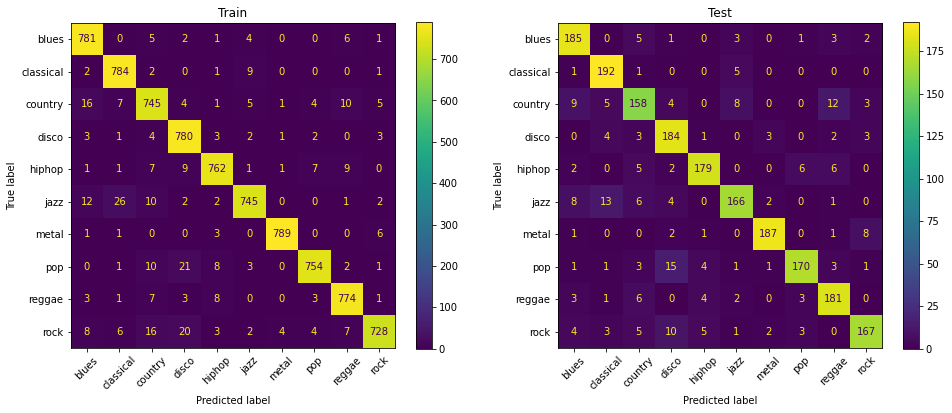

In [76]:
n_neighbors = 3
knn = KNeighborsClassifier(n_neighbors=n_neighbors)
knn.fit(X_train, y_train)

train_score_knn = knn.score(X_train, y_train)
cv_mean_knn = cross_val_score(knn, X_train, y_train, cv=10).mean()
test_score_knn = knn.score(X_test, y_test)

print(f'KNN: {n_neighbors} neighbors')
print()
print('train score:\t', train_score_knn)
print('cv mean:\t', cv_mean_knn)
print('test score:\t', test_score_knn)

# confusion matrix
pred_train = knn.predict(X_train)
pred_test = knn.predict(X_test)
conf_matrix = confusion_matrix(y_train, pred_train)
#display(conf_matrix)

# plot confusion matrix
fig, ax = plt.subplots(1,2, figsize=(16,6))
plot_confusion_matrix(knn, X_train, y_train, ax=ax[0], xticks_rotation=45)
plot_confusion_matrix(knn, X_test, y_test, ax=ax[1], xticks_rotation=45)
ax[0].set_title('Train')
ax[1].set_title('Test')
plt.show()

In [77]:
class_report = classification_report(y_train, pred_train, digits=4)
print()
print('Classification report: train set')
print()
print(class_report)

class_report = classification_report(y_test, pred_test, digits=4)
print()
print('Classification report: test set')
print()
print(class_report)


Classification report: train set

              precision    recall  f1-score   support

       blues     0.9444    0.9762    0.9600       800
   classical     0.9469    0.9812    0.9637       799
     country     0.9243    0.9336    0.9289       798
       disco     0.9275    0.9762    0.9512       799
      hiphop     0.9621    0.9549    0.9585       798
        jazz     0.9663    0.9313    0.9484       800
       metal     0.9912    0.9862    0.9887       800
         pop     0.9742    0.9425    0.9581       800
      reggae     0.9567    0.9675    0.9621       800
        rock     0.9733    0.9123    0.9418       798

    accuracy                         0.9562      7992
   macro avg     0.9567    0.9562    0.9562      7992
weighted avg     0.9567    0.9562    0.9562      7992


Classification report: test set

              precision    recall  f1-score   support

       blues     0.8645    0.9250    0.8937       200
   classical     0.8767    0.9648    0.9187       199
     coun

### Precision - Recall Plot

In [29]:
import scikitplot as skplt
from matplotlib.colors import ListedColormap
cmap = ListedColormap(sns.color_palette("husl", 3))

In [30]:
def plot_f1_lines(figsize=(8,6),fontsize=16):
    '''Create f1-score level lines to be added to the precison-recall plot'''

    fig, ax = plt.subplots(figsize=figsize)
    
    # add lines of constant F1 scores
    
    for const in np.linspace(0.2,0.9,8):
        x_vals = np.linspace(0.001, 0.999, 100)
        y_vals = 1./(2./const-1./x_vals)
        ax.plot(x_vals[y_vals > 0], y_vals[y_vals > 0],
                 color='lightblue', ls='--', alpha=0.9)
        ax.set_ylim([0, 1])
        ax.annotate('f1={0:0.1f}'.format(const),
                     xy=(x_vals[-10], y_vals[-2]+0.0), fontsize=fontsize)

    return fig, ax

In [33]:
proba_train = knn.predict_proba(X_train_pc)
proba_test = knn.predict_proba(X_test_pc)

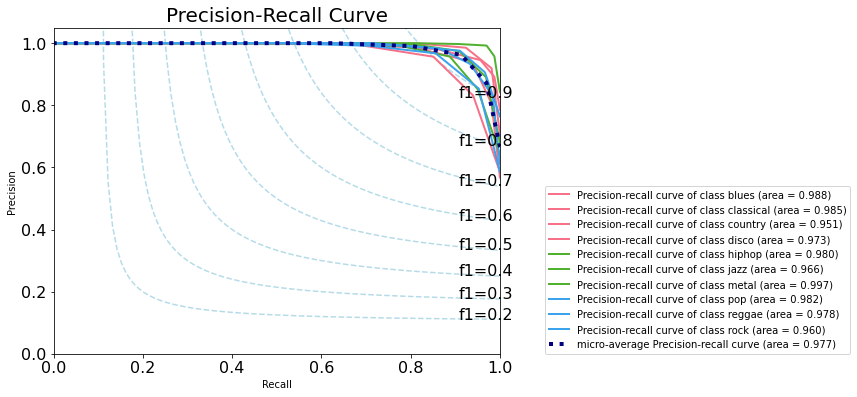

In [34]:
fig, ax = plot_f1_lines()
skplt.metrics.plot_precision_recall(y_train, proba_train, 
                       plot_micro=True, 
                       title_fontsize=20, text_fontsize=16, cmap=cmap, ax=ax)
ax.legend(loc=[1.1,0])
plt.show()

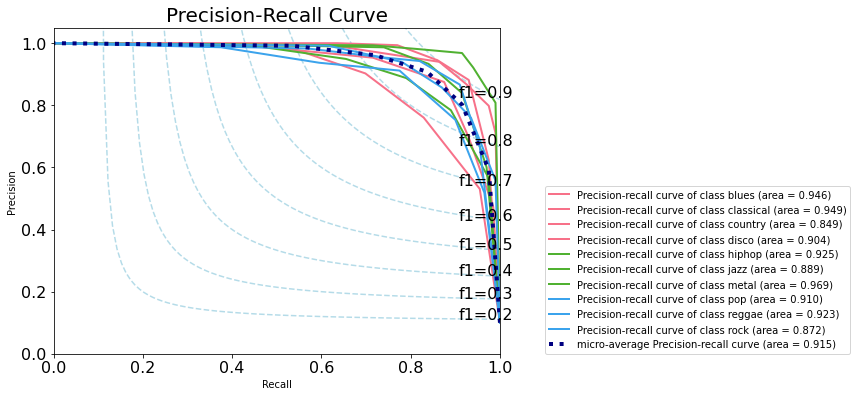

In [35]:
fig, ax = plot_f1_lines()
skplt.metrics.plot_precision_recall(y_test, proba_test, 
                       plot_micro=True, 
                       title_fontsize=20, text_fontsize=16, cmap=cmap, ax=ax)
ax.legend(loc=[1.1,0])
plt.show()

### ROC Plot

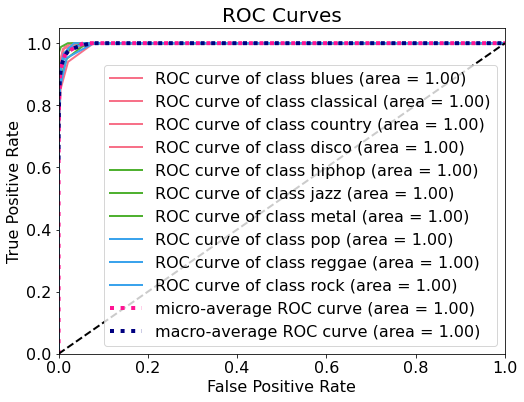

In [37]:
# ROC train
skplt.metrics.plot_roc(y_train, proba_train, plot_micro=True, plot_macro=True, 
                       title_fontsize=20, text_fontsize=16, figsize=(8,6), cmap=cmap)
plt.show()

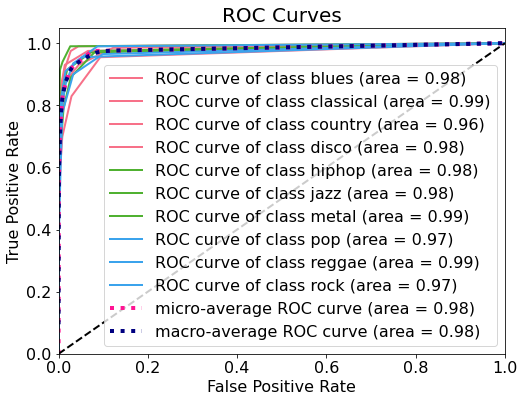

In [38]:
# ROC test
skplt.metrics.plot_roc(y_test, proba_test, plot_micro=True, plot_macro=True, 
                       title_fontsize=20, text_fontsize=16, figsize=(8,6), cmap=cmap)
plt.show()